# Advanced Pattern Analysis for Electron Microscopy Images

This notebook demonstrates the use of the `AdvancedPatternAnalysis` class from the `pattern_analysis.py` module to analyze electron microscopy images for periodic structures and patterns.

In [10]:
# Import necessary libraries
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
from pathlib import Path

# Import our pattern analysis module
from pattern_analysis import AdvancedPatternAnalysis

# Set up matplotlib for better visualization
%matplotlib inline
plt.rcParams['figure.figsize'] = (12, 10)
plt.rcParams['figure.dpi'] = 100

## 1. Set up paths and parameters

In [11]:
# Set path to the selected images folder
image_dir = 'selected_images'

# Create a directory for saving results
results_dir = 'analysis_results'
os.makedirs(results_dir, exist_ok=True)

# List all DM4 files in the selected_images folder
dm4_files = sorted([f for f in os.listdir(image_dir) if f.endswith('.dm4')])
print(f"Found {len(dm4_files)} DM4 files in {image_dir}:")
for i, file in enumerate(dm4_files):
    print(f"{i+1}. {file}")

Found 7 DM4 files in selected_images:
1. Devon_5E w UA -EtOH_20kX_0013.dm4
2. Devon_5E w UA -EtOH_20kX_0021.dm4
3. Devon_5E w UA -EtOH_20kX_0022.dm4
4. Devon_5E w UA -EtOH_20kX_0031.dm4
5. Devon_5E w UA -EtOH_20kX_0032.dm4
6. Devon_5E w UA -EtOH_20kX_0034.dm4
7. Devon_5E w UA -EtOH_20kX_0035.dm4


## 2. Analyze a single image

Let's start by analyzing a single image to demonstrate the workflow.

Analyzing image: Devon_5E w UA -EtOH_20kX_0013.dm4
Loaded DM4 image with shape (3838, 3710)
Pixel size: [0.18341091, 0.18341091] nm


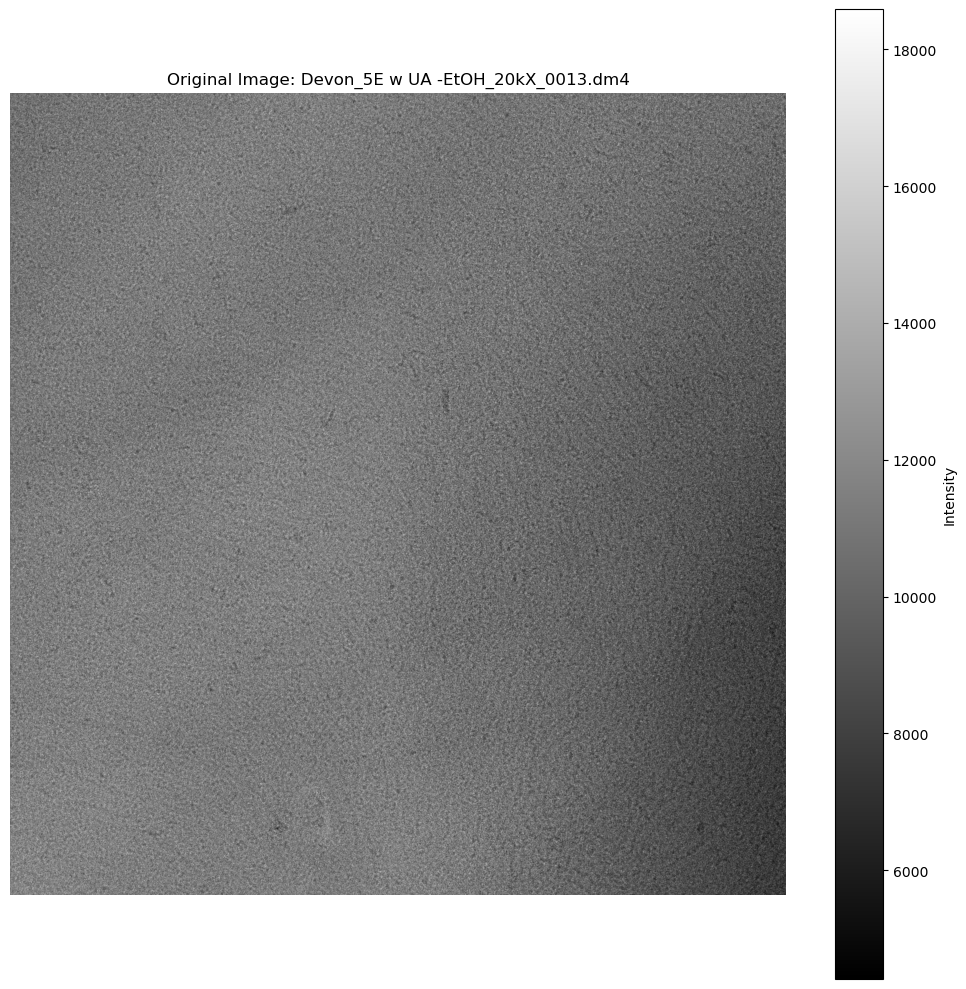

In [12]:
# Select an image to analyze (you can change the index to analyze a different image)
image_index = 0  # First image in the list
selected_image = dm4_files[image_index]
image_path = os.path.join(image_dir, selected_image)

print(f"Analyzing image: {selected_image}")

# Create an analyzer instance
analyzer = AdvancedPatternAnalysis(image_path)

# Display the original image
plt.figure(figsize=(10, 10))
plt.imshow(analyzer.image, cmap='gray')
plt.title(f"Original Image: {selected_image}")
plt.colorbar(label='Intensity')
plt.axis('off')
plt.tight_layout()
plt.show()

## 3. Apply multi-scale denoising

Now let's denoise the image using multiple methods to reduce noise while preserving important features.

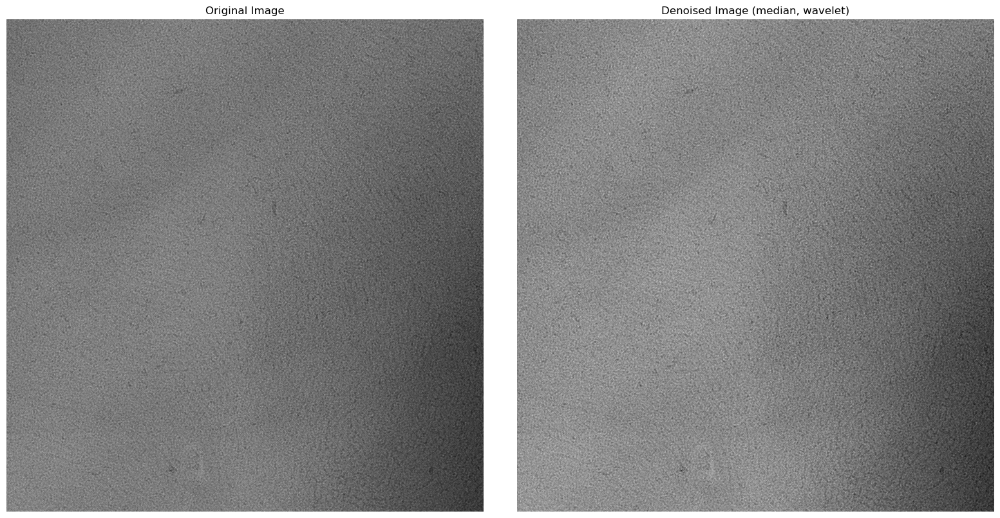

In [13]:
# Define denoising parameters
denoising_methods = ['median', 'wavelet']
denoising_params = {
    'median': {'size': 3},
    'wavelet': {'wavelet': 'db1', 'mode': 'soft', 'wavelet_levels': 3}
}

# Apply denoising
denoised_image = analyzer.multi_scale_denoise(methods=denoising_methods, params=denoising_params)

# Compare original and denoised images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

ax1.imshow(analyzer.image, cmap='gray')
ax1.set_title('Original Image')
ax1.axis('off')

ax2.imshow(denoised_image, cmap='gray')
ax2.set_title(f'Denoised Image ({", ".join(denoising_methods)})')
ax2.axis('off')

plt.tight_layout()
plt.show()

## 4. Global FFT Analysis

Perform global FFT analysis to detect periodic structures in the image.

## Scale Bar Customization

The `visualize_global_fft` method now supports customizing the scale bars with the following parameters:

- `scalebar_length_nm`: Length of the real-space scale bar in nm (default: 100)
- `scalebar_position`: Position of the scale bar ('lower right', 'lower left', 'upper right', 'upper left')
- `scalebar_color`: Color of the scale bar (default: 'white')
- `scalebar_size_vertical`: Thickness of the scale bar in pixels (default: 5)
- `scalebar_font_size`: Font size for the scale bar label (default: 12)

These parameters allow for better visibility of the scale bars in both real-space and FFT images.


In [14]:
analyzer.global_fft_analysis()


{'fft': array([[  89083.32742209-1.13504939e-09j,
          -77898.02728303-4.18446978e+02j,
           53296.85102169-6.62081802e+04j, ...,
          -38560.17351508-1.11608764e+05j,
           53296.85102169+6.62081802e+04j,
          -77898.02728303+4.18446978e+02j],
        [ -60844.35036196-1.64423641e+04j,
           90040.04589601+4.55395196e+04j,
          -98791.52889839-7.43750695e+03j, ...,
            7778.28792264+6.96829512e+04j,
          -13077.63996164-5.88684993e+04j,
           25706.30567654+2.27156095e+04j],
        [  25544.03756226+7.10325568e+04j,
          -18818.54433892-1.17469724e+05j,
           48744.08636985+9.87872142e+04j, ...,
          -53248.68518611-3.41951845e+04j,
           88337.01454316+1.02342450e+04j,
          -69937.02806006-7.31509585e+03j],
        ...,
        [ -39799.30160632+1.79298534e+04j,
          130423.31365567+8.97099121e+04j,
         -163324.71268132-2.61900766e+04j, ...,
          -57425.52933967-5.72704695e+04j,
           

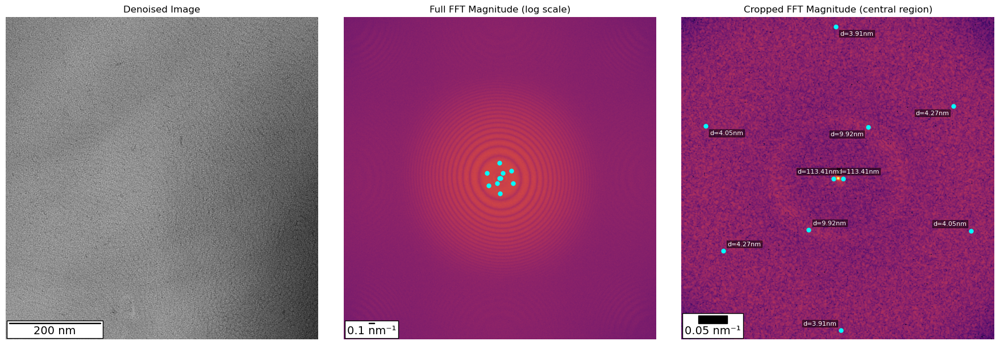

In [15]:
# Visualize global FFT with customized scale bars
fig = analyzer.visualize_global_fft(
    crop_factor=0.05,
    scalebar_length_nm=200,           # Larger scale bar (200 nm instead of 100 nm)
    scalebar_position='lower left',   # Position in lower left corner
    scalebar_color='k',          # Yellow color for better visibility
    scalebar_size_vertical=10,        # Thicker scale bar
    scalebar_font_size=14             # Larger font size
)
plt.show()


## Peak Labels in Cropped FFT

The peak labels have been moved from the full FFT to the cropped FFT for better visibility.
This makes it easier to identify specific d-spacing values in the zoomed-in view of the FFT.

The updated visualization now shows:
- Cyan markers in both the full FFT and cropped FFT
- d-spacing labels only in the cropped FFT
- Labels positioned intelligently based on their location in the view


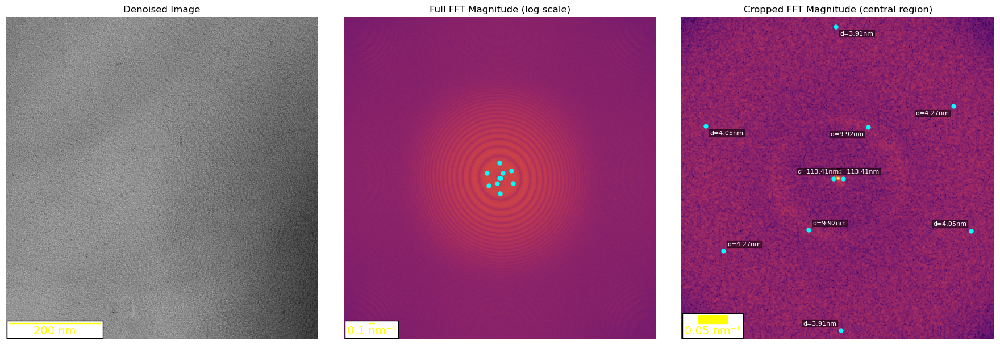

In [16]:
# Run global FFT analysis first
analyzer.global_fft_analysis()

# Visualize with peak labels in the cropped FFT
fig = analyzer.visualize_global_fft(
    crop_factor=0.05,
    scalebar_length_nm=200,           # Larger scale bar (200 nm instead of 100 nm)
    scalebar_position='lower left',   # Position in lower left corner
    scalebar_color='yellow',          # Yellow color for better visibility
    scalebar_size_vertical=10,        # Thicker scale bar
    scalebar_font_size=14             # Larger font size
)
plt.show()


## 5. Windowed FFT Analysis

Perform windowed FFT analysis to identify localized patterns in different regions of the image.

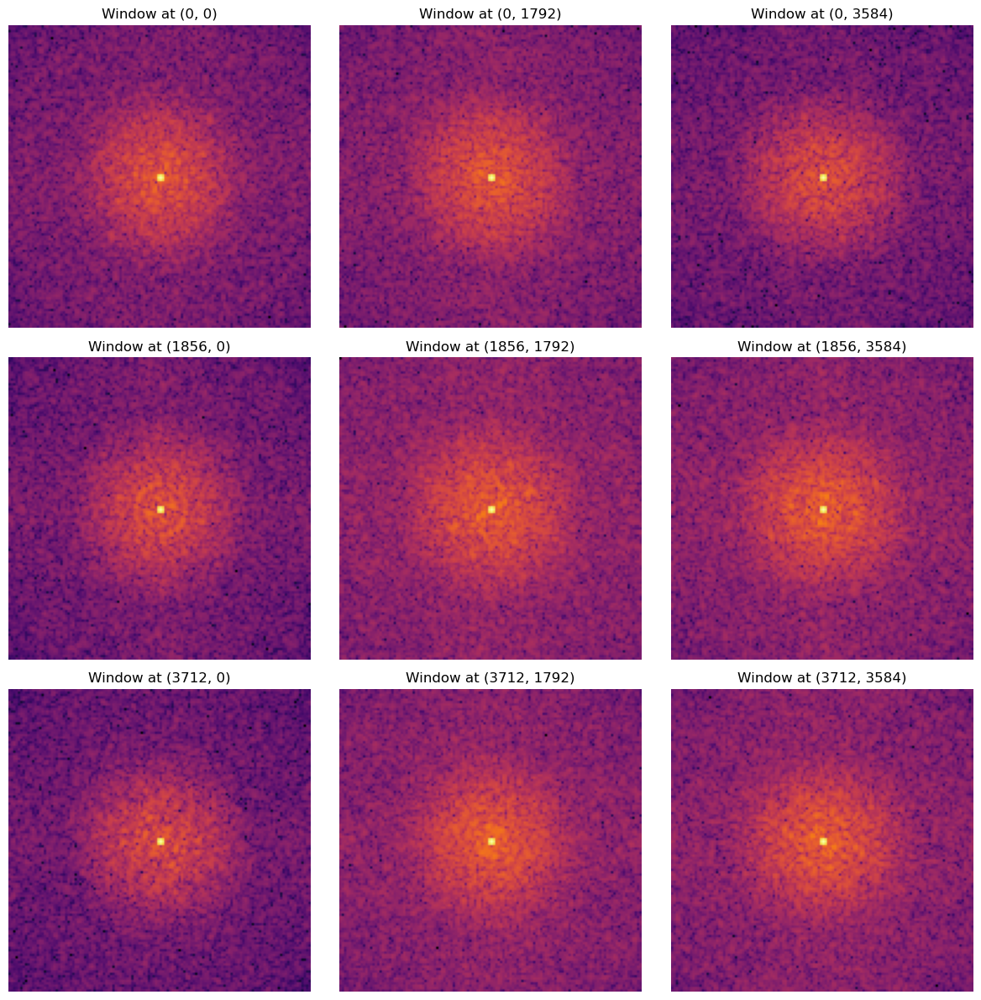

In [17]:
# Perform windowed FFT analysis
window_size = 128  # Size of the window (adjust based on your image features)
step = 64  # Step size for sliding the window

windowed_results = analyzer.windowed_fft_analysis(window_size=window_size, step=step)

# Display a sample of windowed FFT results
n_h, n_w = windowed_results['n_h'], windowed_results['n_w']
fft_magnitudes = windowed_results['fft_magnitudes']

# Create a grid of sample FFTs
fig, axs = plt.subplots(3, 3, figsize=(12, 12))
axs = axs.flatten()

# Sample positions from the grid
positions = [
    (0, 0), (0, n_w//2), (0, n_w-1),
    (n_h//2, 0), (n_h//2, n_w//2), (n_h//2, n_w-1),
    (n_h-1, 0), (n_h-1, n_w//2), (n_h-1, n_w-1)
]

for i, (y, x) in enumerate(positions):
    if y < n_h and x < n_w:  # Make sure position is valid
        axs[i].imshow(fft_magnitudes[y, x], cmap='inferno')
        axs[i].set_title(f"Window at ({y*step}, {x*step})")
        axs[i].axis('off')

plt.tight_layout()
plt.show()

## 6. Pattern Decomposition using PCA

Decompose the windowed FFT patterns using Principal Component Analysis (PCA) to identify the dominant patterns.

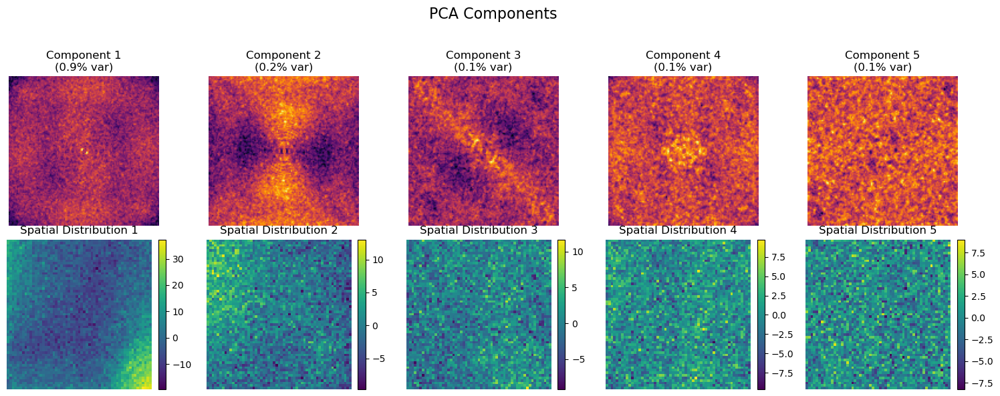


Explained variance by PCA components:
Component 1: 0.92%
Component 2: 0.17%
Component 3: 0.11%
Component 4: 0.10%
Component 5: 0.10%
Total explained variance: 1.40%


In [18]:
# Perform PCA decomposition
n_components = 5  # Number of components to extract
pca_results = analyzer.decompose_patterns(n_components=n_components, method='pca')

# Visualize PCA results
fig = analyzer.visualize_decomposition(method='pca')
plt.show()

# Print explained variance for each component
print("\nExplained variance by PCA components:")
for i, var in enumerate(pca_results['explained_variance']):
    print(f"Component {i+1}: {var*100:.2f}%")
print(f"Total explained variance: {sum(pca_results['explained_variance'])*100:.2f}%")

## 7. Pattern Decomposition using NMF

Decompose the windowed FFT patterns using Non-negative Matrix Factorization (NMF) for an alternative view of the patterns.

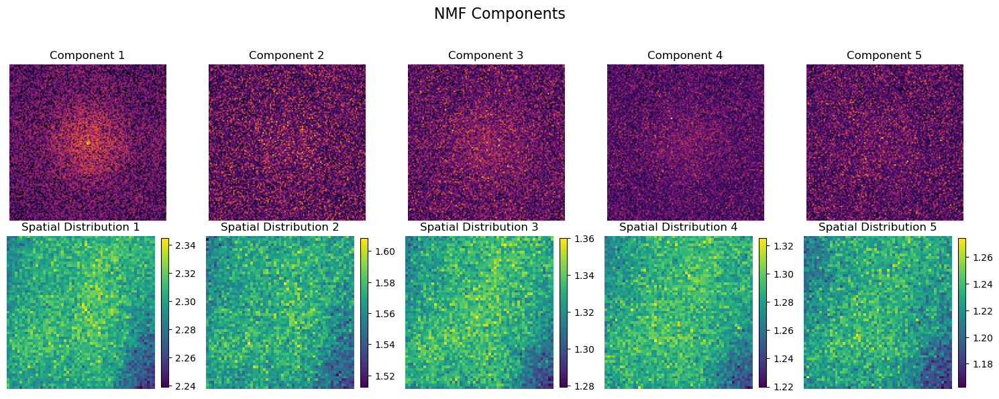

In [19]:
# Perform NMF decomposition
nmf_results = analyzer.decompose_patterns(n_components=n_components, method='nmf')

# Visualize NMF results
fig = analyzer.visualize_decomposition(method='nmf')
plt.show()

## 8. Batch Processing Multiple Images

Now let's process all images in the folder and compare their results.

In [20]:
# Function to process a single image
def process_image(image_path, save_dir):
    # Extract image name
    image_name = os.path.basename(image_path).split('.')[0]
    
    # Create image-specific save directory
    image_save_dir = os.path.join(save_dir, image_name)
    os.makedirs(image_save_dir, exist_ok=True)
    
    # Create analyzer and run full analysis
    analyzer = AdvancedPatternAnalysis(image_path)
    results = analyzer.run_full_analysis(
        denoising_methods=['median', 'wavelet'],
        window_size=128,
        n_components=5,
        decomposition_method='pca',
        save_dir=image_save_dir
    )
    
    return {
        'image_name': image_name,
        'peaks': results['fft_result']['peaks'][:5],  # Top 5 peaks
        'save_dir': image_save_dir
    }

Processing image 1/3: Devon_5E w UA -EtOH_20kX_0013.dm4
Loaded DM4 image with shape (3838, 3710)
Pixel size: [0.18341091, 0.18341091] nm
Applying multi-scale denoising...
Performing global FFT analysis...
Global FFT results saved to analysis_results/Devon_5E w UA -EtOH_20kX_0013/global_fft_analysis.png
Performing windowed FFT analysis with window size 128...
Decomposing patterns using PCA with 5 components...
Decomposition results saved to analysis_results/Devon_5E w UA -EtOH_20kX_0013/pca_decomposition.png
  Results saved to analysis_results/Devon_5E w UA -EtOH_20kX_0013
  Top peaks found:
    Peak 1: d-spacing = 113.41 nm, angle = 180.0°
    Peak 2: d-spacing = 113.41 nm, angle = 0.0°
    Peak 3: d-spacing = 3.91 nm, angle = -91.0°
    Peak 4: d-spacing = 3.91 nm, angle = 89.0°
    Peak 5: d-spacing = 9.92 nm, angle = -59.3°

Processing image 2/3: Devon_5E w UA -EtOH_20kX_0021.dm4
Loaded DM4 image with shape (3838, 3710)
Pixel size: [0.18341091, 0.18341091] nm
Applying multi-scale de

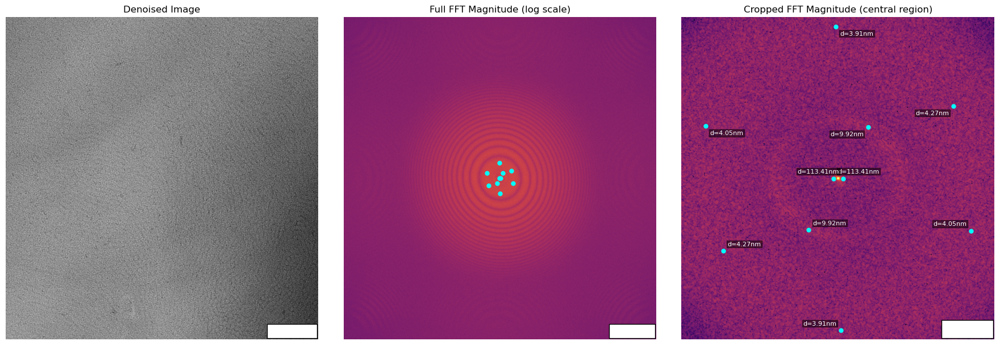

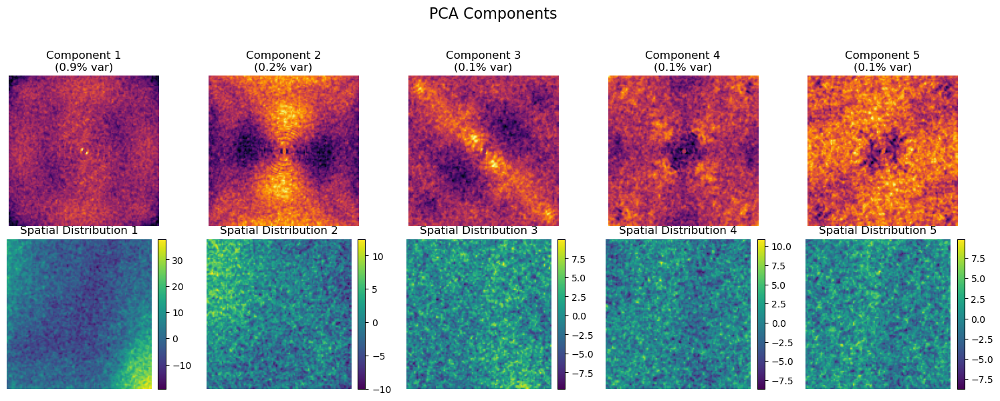

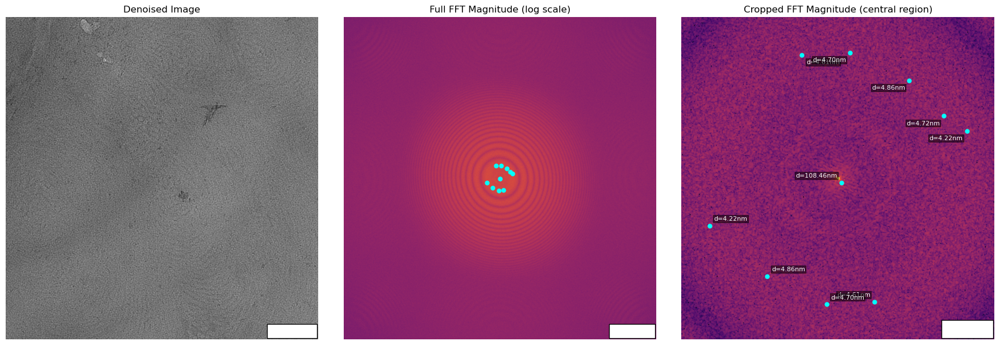

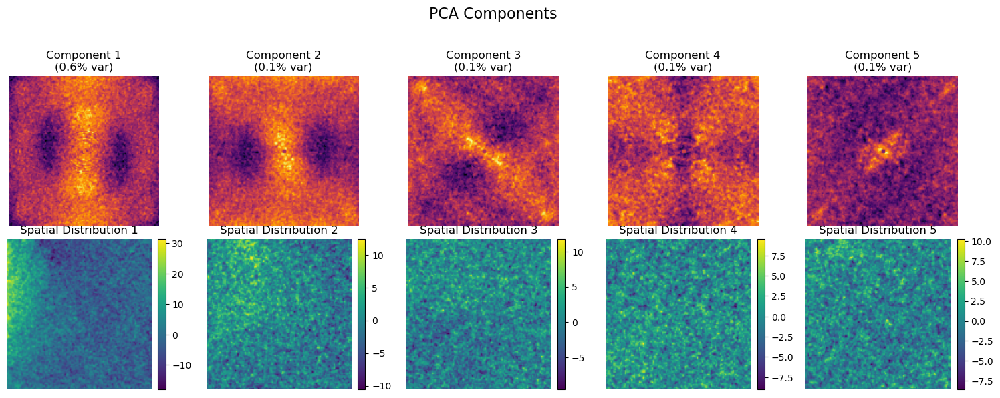

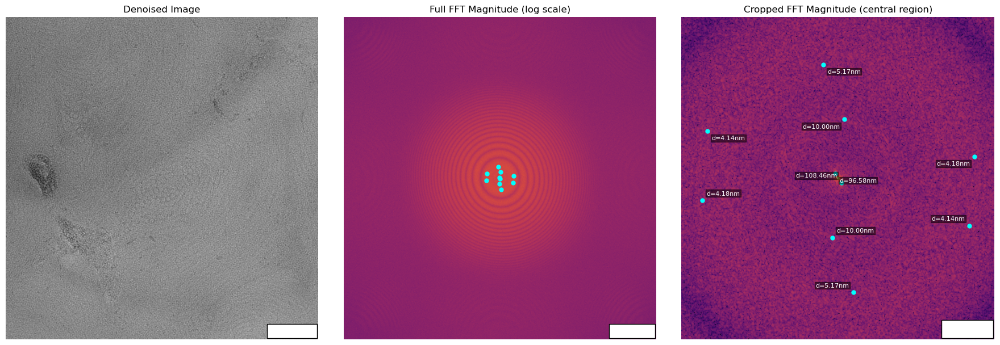

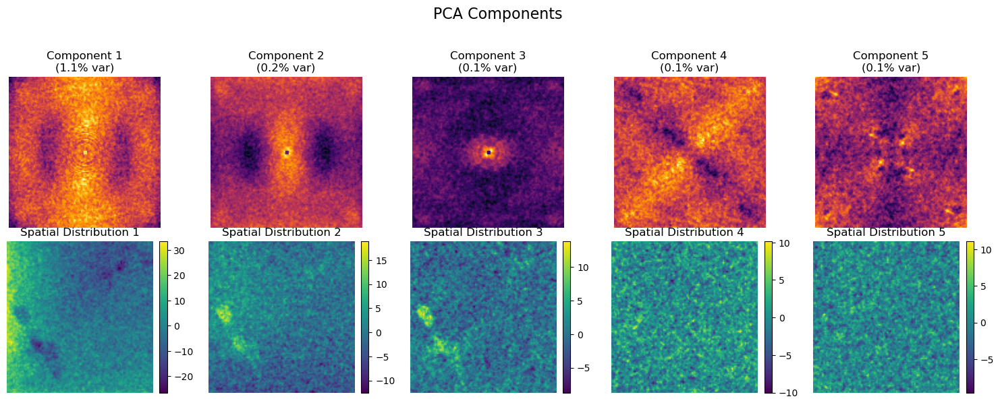

In [21]:
# Process a subset of images (you can adjust the range to process more or fewer images)
num_images_to_process = min(3, len(dm4_files))  # Process up to 3 images
batch_results = []

for i in range(num_images_to_process):
    image_path = os.path.join(image_dir, dm4_files[i])
    print(f"Processing image {i+1}/{num_images_to_process}: {dm4_files[i]}")
    result = process_image(image_path, results_dir)
    batch_results.append(result)
    print(f"  Results saved to {result['save_dir']}")
    print("  Top peaks found:")
    for j, peak in enumerate(result['peaks']):
        print(f"    Peak {j+1}: d-spacing = {peak['d_spacing']:.2f} nm, angle = {peak['angle']:.1f}°")
    print()

## 9. Compare Results Across Images

Let's compare the d-spacings found across different images to identify consistent patterns.

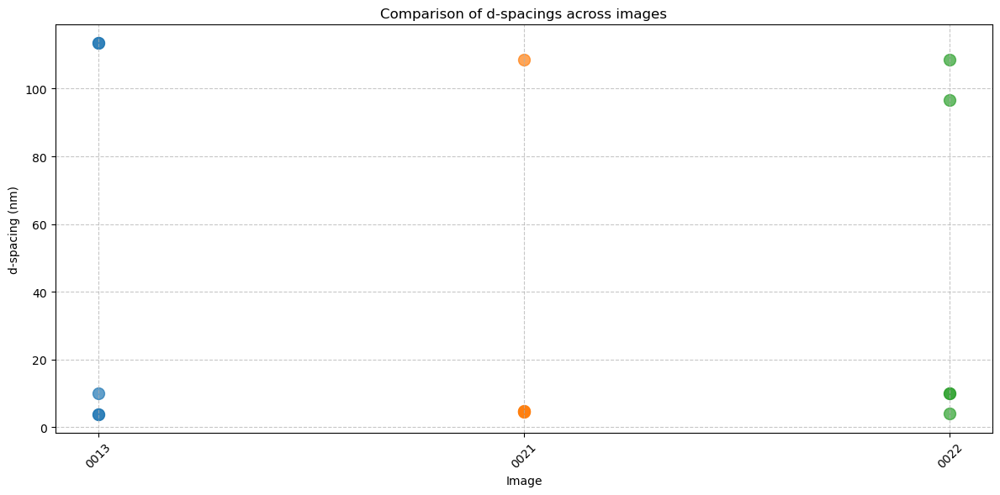

In [22]:
# Extract d-spacings from all processed images
all_d_spacings = []
image_names = []

for result in batch_results:
    image_names.append(result['image_name'])
    d_spacings = [peak['d_spacing'] for peak in result['peaks']]
    all_d_spacings.append(d_spacings)

# Plot comparison of d-spacings
fig, ax = plt.subplots(figsize=(12, 6))

for i, (name, d_spacings) in enumerate(zip(image_names, all_d_spacings)):
    ax.scatter([i] * len(d_spacings), d_spacings, label=name, s=100, alpha=0.7)

ax.set_xlabel('Image')
ax.set_ylabel('d-spacing (nm)')
ax.set_title('Comparison of d-spacings across images')
ax.set_xticks(range(len(image_names)))
ax.set_xticklabels([name.split('_')[-1] for name in image_names], rotation=45)
ax.grid(True, linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

## 10. Advanced Analysis: Focus on a Specific d-spacing

If you identified a consistent d-spacing across images, you can focus on that specific periodicity.

In [23]:
# Let's assume we found a consistent d-spacing around X nm
# Replace X with a value you observed in the previous analysis
target_d_spacing = 5.0  # Example value in nm
tolerance = 0.5  # Tolerance range in nm

# Function to create a band-pass filter for a specific d-spacing
def create_dspacing_filter(image_shape, d_spacing, tolerance, pixel_size):
    h, w = image_shape
    y, x = np.ogrid[-h//2:h//2, -w//2:w//2]
    
    # Calculate distance from center in frequency space
    r = np.sqrt(x*x + y*y)
    
    # Convert d-spacing to frequency
    if isinstance(pixel_size, (list, tuple)):
        pixel_size_val = pixel_size[0]
    else:
        pixel_size_val = pixel_size
        
    # Calculate frequency corresponding to d-spacing
    # f = 1/d in real space units
    freq = 1.0 / d_spacing
    
    # Convert to pixel units in frequency space
    freq_px = freq * pixel_size_val * max(h, w)
    
    # Calculate tolerance in pixel units
    tol_min = 1.0 / (d_spacing + tolerance) * pixel_size_val * max(h, w)
    tol_max = 1.0 / (d_spacing - tolerance) * pixel_size_val * max(h, w) if d_spacing > tolerance else np.inf
    
    # Create band-pass filter
    band_filter = (r >= tol_min) & (r <= tol_max)
    
    return band_filter.astype(float)

Loaded DM4 image with shape (3838, 3710)
Pixel size: [0.18341091, 0.18341091] nm


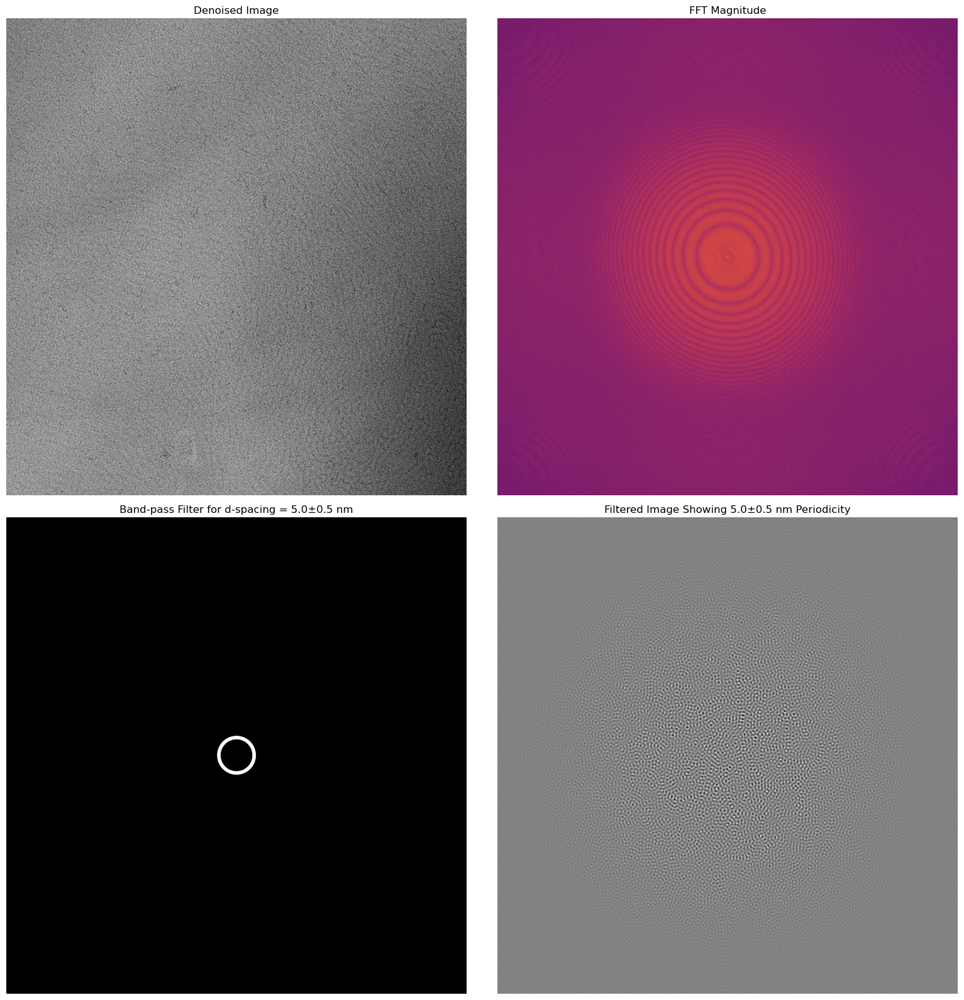

In [24]:
# Apply the filter to the first image as an example
image_path = os.path.join(image_dir, dm4_files[0])
analyzer = AdvancedPatternAnalysis(image_path)

# Denoise the image
analyzer.multi_scale_denoise(methods=['median', 'wavelet'])

# Calculate FFT
analyzer.global_fft_analysis()
fft = analyzer.fft_result['fft']

# Create filter for the target d-spacing
d_filter = create_dspacing_filter(fft.shape, target_d_spacing, tolerance, analyzer.pixel_size)

# Apply filter to FFT
filtered_fft = fft * d_filter

# Inverse FFT to get filtered image
filtered_image = np.real(np.fft.ifft2(np.fft.ifftshift(filtered_fft)))

# Visualize results
fig, axs = plt.subplots(2, 2, figsize=(16, 16))

# Original image
axs[0, 0].imshow(analyzer.denoised_image, cmap='gray')
axs[0, 0].set_title('Denoised Image')
axs[0, 0].axis('off')

# Original FFT
axs[0, 1].imshow(np.log1p(np.abs(fft)), cmap='inferno')
axs[0, 1].set_title('FFT Magnitude')
axs[0, 1].axis('off')

# Filter
axs[1, 0].imshow(d_filter, cmap='gray')
axs[1, 0].set_title(f'Band-pass Filter for d-spacing = {target_d_spacing}±{tolerance} nm')
axs[1, 0].axis('off')

# Filtered image
axs[1, 1].imshow(filtered_image, cmap='gray')
axs[1, 1].set_title(f'Filtered Image Showing {target_d_spacing}±{tolerance} nm Periodicity')
axs[1, 1].axis('off')

plt.tight_layout()
plt.show()